In [0]:
from pyspark.sql import functions as F
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [0]:
# File location and type
file_location = "/FileStore/tables/yellow_tripdata_2024_01.parquet"
file_type = "parquet"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

# The applied options are for CSV files. For other file types, these will be ignored.
df = spark.read.format(file_type) \
  .option("inferSchema", infer_schema) \
  .option("header", first_row_is_header) \
  .option("sep", delimiter) \
  .load(file_location)

display(df)

VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee
2,2024-01-01T00:57:55.000+0000,2024-01-01T01:17:43.000+0000,1,1.72,1,N,186,79,2,17.7,1.0,0.5,0.0,0.0,1.0,22.7,2.5,0.0
1,2024-01-01T00:03:00.000+0000,2024-01-01T00:09:36.000+0000,1,1.8,1,N,140,236,1,10.0,3.5,0.5,3.75,0.0,1.0,18.75,2.5,0.0
1,2024-01-01T00:17:06.000+0000,2024-01-01T00:35:01.000+0000,1,4.7,1,N,236,79,1,23.3,3.5,0.5,3.0,0.0,1.0,31.3,2.5,0.0
1,2024-01-01T00:36:38.000+0000,2024-01-01T00:44:56.000+0000,1,1.4,1,N,79,211,1,10.0,3.5,0.5,2.0,0.0,1.0,17.0,2.5,0.0
1,2024-01-01T00:46:51.000+0000,2024-01-01T00:52:57.000+0000,1,0.8,1,N,211,148,1,7.9,3.5,0.5,3.2,0.0,1.0,16.1,2.5,0.0
1,2024-01-01T00:54:08.000+0000,2024-01-01T01:26:31.000+0000,1,4.7,1,N,148,141,1,29.6,3.5,0.5,6.9,0.0,1.0,41.5,2.5,0.0
2,2024-01-01T00:49:44.000+0000,2024-01-01T01:15:47.000+0000,2,10.82,1,N,138,181,1,45.7,6.0,0.5,10.0,0.0,1.0,64.95,0.0,1.75
1,2024-01-01T00:30:40.000+0000,2024-01-01T00:58:40.000+0000,0,3.0,1,N,246,231,2,25.4,3.5,0.5,0.0,0.0,1.0,30.4,2.5,0.0
2,2024-01-01T00:26:01.000+0000,2024-01-01T00:54:12.000+0000,1,5.44,1,N,161,261,2,31.0,1.0,0.5,0.0,0.0,1.0,36.0,2.5,0.0
2,2024-01-01T00:28:08.000+0000,2024-01-01T00:29:16.000+0000,1,0.04,1,N,113,113,2,3.0,1.0,0.5,0.0,0.0,1.0,8.0,2.5,0.0


In [0]:
df = spark.read.parquet('/FileStore/tables/yellow_tripdata_2024_01.parquet', header='true', inferSchema='true')
df.display()

VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee
2,2024-01-01T00:57:55.000+0000,2024-01-01T01:17:43.000+0000,1,1.72,1,N,186,79,2,17.7,1.0,0.5,0.0,0.0,1.0,22.7,2.5,0.0
1,2024-01-01T00:03:00.000+0000,2024-01-01T00:09:36.000+0000,1,1.8,1,N,140,236,1,10.0,3.5,0.5,3.75,0.0,1.0,18.75,2.5,0.0
1,2024-01-01T00:17:06.000+0000,2024-01-01T00:35:01.000+0000,1,4.7,1,N,236,79,1,23.3,3.5,0.5,3.0,0.0,1.0,31.3,2.5,0.0
1,2024-01-01T00:36:38.000+0000,2024-01-01T00:44:56.000+0000,1,1.4,1,N,79,211,1,10.0,3.5,0.5,2.0,0.0,1.0,17.0,2.5,0.0
1,2024-01-01T00:46:51.000+0000,2024-01-01T00:52:57.000+0000,1,0.8,1,N,211,148,1,7.9,3.5,0.5,3.2,0.0,1.0,16.1,2.5,0.0
1,2024-01-01T00:54:08.000+0000,2024-01-01T01:26:31.000+0000,1,4.7,1,N,148,141,1,29.6,3.5,0.5,6.9,0.0,1.0,41.5,2.5,0.0
2,2024-01-01T00:49:44.000+0000,2024-01-01T01:15:47.000+0000,2,10.82,1,N,138,181,1,45.7,6.0,0.5,10.0,0.0,1.0,64.95,0.0,1.75
1,2024-01-01T00:30:40.000+0000,2024-01-01T00:58:40.000+0000,0,3.0,1,N,246,231,2,25.4,3.5,0.5,0.0,0.0,1.0,30.4,2.5,0.0
2,2024-01-01T00:26:01.000+0000,2024-01-01T00:54:12.000+0000,1,5.44,1,N,161,261,2,31.0,1.0,0.5,0.0,0.0,1.0,36.0,2.5,0.0
2,2024-01-01T00:28:08.000+0000,2024-01-01T00:29:16.000+0000,1,0.04,1,N,113,113,2,3.0,1.0,0.5,0.0,0.0,1.0,8.0,2.5,0.0


In [0]:
# Drop rows with any nulls
null_counts = df.select([F.sum(F.col(c).isNull().cast("int")).alias(c) for c in df.columns])
null_counts.show()

df_dropna = df.na.drop()

+--------+--------------------+---------------------+---------------+-------------+----------+------------------+------------+------------+------------+-----------+-----+-------+----------+------------+---------------------+------------+--------------------+-----------+
|VendorID|tpep_pickup_datetime|tpep_dropoff_datetime|passenger_count|trip_distance|RatecodeID|store_and_fwd_flag|PULocationID|DOLocationID|payment_type|fare_amount|extra|mta_tax|tip_amount|tolls_amount|improvement_surcharge|total_amount|congestion_surcharge|Airport_fee|
+--------+--------------------+---------------------+---------------+-------------+----------+------------------+------------+------------+------------+-----------+-----+-------+----------+------------+---------------------+------------+--------------------+-----------+
|       2| 2024-01-01 00:57:55|  2024-01-01 01:17:43|              1|         1.72|         1|                 N|         186|          79|           2|       17.7|  1.0|    0.5|       0.

In [0]:
df_dropna = df_dropna.dropDuplicates()
df_dropna.display()

In [0]:
df_dropna.printSchema()

root
 |-- VendorID: integer (nullable = true)
 |-- tpep_pickup_datetime: timestamp (nullable = true)
 |-- tpep_dropoff_datetime: timestamp (nullable = true)
 |-- passenger_count: long (nullable = true)
 |-- trip_distance: double (nullable = true)
 |-- RatecodeID: long (nullable = true)
 |-- store_and_fwd_flag: string (nullable = true)
 |-- PULocationID: integer (nullable = true)
 |-- DOLocationID: integer (nullable = true)
 |-- payment_type: long (nullable = true)
 |-- fare_amount: double (nullable = true)
 |-- extra: double (nullable = true)
 |-- mta_tax: double (nullable = true)
 |-- tip_amount: double (nullable = true)
 |-- tolls_amount: double (nullable = true)
 |-- improvement_surcharge: double (nullable = true)
 |-- total_amount: double (nullable = true)
 |-- congestion_surcharge: double (nullable = true)
 |-- Airport_fee: double (nullable = true)



In [0]:
df_dropna.describe().display()

summary,VendorID,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee
count,2824462,2824462,2824462,2824462,2824462,2824462,2824462,2824462,2824462,2824462,2824462,2824462,2824462,2824462,2824462,2824462,2824462
mean,1.758794064143897,1.3392808966805005,3.2540712744580818,2.069359403666964,null,166.2218036567672,165.48765747246733,1.2188979706577747,18.083696997871954,1.5166967372901474,0.4826833570428634,3.424693240696802,0.5354312219435446,0.9745405319667937,26.850621339542258,2.2561220508542865,0.141161130863152
stddev,0.42781502680957206,0.8502816924800723,12.132039235324262,9.823218952795447,null,63.19553340998129,69.19925282846486,0.5328322049565883,19.192730126481035,1.817543432775674,0.12033317212869524,3.918858360557717,2.144406220102183,0.22344123385023898,23.705918768632927,0.8232746699398134,0.4876238872392937
min,1,0,0.0,1,N,1,1,1,-899.0,-7.5,-0.5,-80.0,-80.0,-1.0,-900.0,-2.5,-1.75
max,2,9,15400.32,99,Y,265,265,4,5000.0,14.25,4.0,428.0,115.92,1.0,5000.0,2.5,1.75


In [0]:
df_with_date_cols = df_dropna.withColumn("year", F.year("tpep_pickup_datetime")) \
    .withColumn("month", F.month("tpep_pickup_datetime")) \
    .withColumn("day", F.dayofmonth("tpep_pickup_datetime")) \
    .withColumn("hour", F.hour("tpep_pickup_datetime")) \
    .withColumn("day_of_week", F.dayofweek("tpep_pickup_datetime"))
df_with_date_cols.display()

VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,year,month,day,hour,day_of_week
2,2024-01-01T00:57:55.000+0000,2024-01-01T01:17:43.000+0000,1,1.72,1,N,186,79,2,17.7,1.0,0.5,0.0,0.0,1.0,22.7,2.5,0.0,2024,1,1,0,2
1,2024-01-01T00:03:00.000+0000,2024-01-01T00:09:36.000+0000,1,1.8,1,N,140,236,1,10.0,3.5,0.5,3.75,0.0,1.0,18.75,2.5,0.0,2024,1,1,0,2
1,2024-01-01T00:17:06.000+0000,2024-01-01T00:35:01.000+0000,1,4.7,1,N,236,79,1,23.3,3.5,0.5,3.0,0.0,1.0,31.3,2.5,0.0,2024,1,1,0,2
1,2024-01-01T00:36:38.000+0000,2024-01-01T00:44:56.000+0000,1,1.4,1,N,79,211,1,10.0,3.5,0.5,2.0,0.0,1.0,17.0,2.5,0.0,2024,1,1,0,2
1,2024-01-01T00:46:51.000+0000,2024-01-01T00:52:57.000+0000,1,0.8,1,N,211,148,1,7.9,3.5,0.5,3.2,0.0,1.0,16.1,2.5,0.0,2024,1,1,0,2
1,2024-01-01T00:54:08.000+0000,2024-01-01T01:26:31.000+0000,1,4.7,1,N,148,141,1,29.6,3.5,0.5,6.9,0.0,1.0,41.5,2.5,0.0,2024,1,1,0,2
2,2024-01-01T00:49:44.000+0000,2024-01-01T01:15:47.000+0000,2,10.82,1,N,138,181,1,45.7,6.0,0.5,10.0,0.0,1.0,64.95,0.0,1.75,2024,1,1,0,2
1,2024-01-01T00:30:40.000+0000,2024-01-01T00:58:40.000+0000,0,3.0,1,N,246,231,2,25.4,3.5,0.5,0.0,0.0,1.0,30.4,2.5,0.0,2024,1,1,0,2
2,2024-01-01T00:26:01.000+0000,2024-01-01T00:54:12.000+0000,1,5.44,1,N,161,261,2,31.0,1.0,0.5,0.0,0.0,1.0,36.0,2.5,0.0,2024,1,1,0,2
2,2024-01-01T00:28:08.000+0000,2024-01-01T00:29:16.000+0000,1,0.04,1,N,113,113,2,3.0,1.0,0.5,0.0,0.0,1.0,8.0,2.5,0.0,2024,1,1,0,2


In [0]:
df_with_trip_duration = df_with_date_cols.withColumn("trip_duration", 
    F.unix_timestamp("tpep_dropoff_datetime") - F.unix_timestamp("tpep_pickup_datetime"))
df_with_trip_duration.display()

VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,year,month,day,hour,day_of_week,trip_duration
2,2024-01-01T00:57:55.000+0000,2024-01-01T01:17:43.000+0000,1,1.72,1,N,186,79,2,17.7,1.0,0.5,0.0,0.0,1.0,22.7,2.5,0.0,2024,1,1,0,2,1188
1,2024-01-01T00:03:00.000+0000,2024-01-01T00:09:36.000+0000,1,1.8,1,N,140,236,1,10.0,3.5,0.5,3.75,0.0,1.0,18.75,2.5,0.0,2024,1,1,0,2,396
1,2024-01-01T00:17:06.000+0000,2024-01-01T00:35:01.000+0000,1,4.7,1,N,236,79,1,23.3,3.5,0.5,3.0,0.0,1.0,31.3,2.5,0.0,2024,1,1,0,2,1075
1,2024-01-01T00:36:38.000+0000,2024-01-01T00:44:56.000+0000,1,1.4,1,N,79,211,1,10.0,3.5,0.5,2.0,0.0,1.0,17.0,2.5,0.0,2024,1,1,0,2,498
1,2024-01-01T00:46:51.000+0000,2024-01-01T00:52:57.000+0000,1,0.8,1,N,211,148,1,7.9,3.5,0.5,3.2,0.0,1.0,16.1,2.5,0.0,2024,1,1,0,2,366
1,2024-01-01T00:54:08.000+0000,2024-01-01T01:26:31.000+0000,1,4.7,1,N,148,141,1,29.6,3.5,0.5,6.9,0.0,1.0,41.5,2.5,0.0,2024,1,1,0,2,1943
2,2024-01-01T00:49:44.000+0000,2024-01-01T01:15:47.000+0000,2,10.82,1,N,138,181,1,45.7,6.0,0.5,10.0,0.0,1.0,64.95,0.0,1.75,2024,1,1,0,2,1563
1,2024-01-01T00:30:40.000+0000,2024-01-01T00:58:40.000+0000,0,3.0,1,N,246,231,2,25.4,3.5,0.5,0.0,0.0,1.0,30.4,2.5,0.0,2024,1,1,0,2,1680
2,2024-01-01T00:26:01.000+0000,2024-01-01T00:54:12.000+0000,1,5.44,1,N,161,261,2,31.0,1.0,0.5,0.0,0.0,1.0,36.0,2.5,0.0,2024,1,1,0,2,1691
2,2024-01-01T00:28:08.000+0000,2024-01-01T00:29:16.000+0000,1,0.04,1,N,113,113,2,3.0,1.0,0.5,0.0,0.0,1.0,8.0,2.5,0.0,2024,1,1,0,2,68


In [0]:
print(f"Number of rows: {df_with_trip_duration.count()}")
df_filtered = df_with_trip_duration.filter(df_with_trip_duration["trip_duration"] > 0)
df_filtered = df_filtered.filter(df_filtered["passenger_count"] > 0)
df_filtered = df_filtered.filter(df_filtered["trip_distance"] > 0)
df_filtered = df_filtered.filter(df_filtered["fare_amount"] > 0)
df_filtered = df_filtered.filter(df_filtered["total_amount"] > 0)
print(f"Number of rows: {df_filtered.count()}")

Number of rows: 2824462
Number of rows: 2723750


In [0]:
df_filtered.display()

VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,year,month,day,hour,day_of_week,trip_duration
2,2024-01-01T00:57:55.000+0000,2024-01-01T01:17:43.000+0000,1,1.72,1,N,186,79,2,17.7,1.0,0.5,0.0,0.0,1.0,22.7,2.5,0.0,2024,1,1,0,2,1188
1,2024-01-01T00:03:00.000+0000,2024-01-01T00:09:36.000+0000,1,1.8,1,N,140,236,1,10.0,3.5,0.5,3.75,0.0,1.0,18.75,2.5,0.0,2024,1,1,0,2,396
1,2024-01-01T00:17:06.000+0000,2024-01-01T00:35:01.000+0000,1,4.7,1,N,236,79,1,23.3,3.5,0.5,3.0,0.0,1.0,31.3,2.5,0.0,2024,1,1,0,2,1075
1,2024-01-01T00:36:38.000+0000,2024-01-01T00:44:56.000+0000,1,1.4,1,N,79,211,1,10.0,3.5,0.5,2.0,0.0,1.0,17.0,2.5,0.0,2024,1,1,0,2,498
1,2024-01-01T00:46:51.000+0000,2024-01-01T00:52:57.000+0000,1,0.8,1,N,211,148,1,7.9,3.5,0.5,3.2,0.0,1.0,16.1,2.5,0.0,2024,1,1,0,2,366
1,2024-01-01T00:54:08.000+0000,2024-01-01T01:26:31.000+0000,1,4.7,1,N,148,141,1,29.6,3.5,0.5,6.9,0.0,1.0,41.5,2.5,0.0,2024,1,1,0,2,1943
2,2024-01-01T00:49:44.000+0000,2024-01-01T01:15:47.000+0000,2,10.82,1,N,138,181,1,45.7,6.0,0.5,10.0,0.0,1.0,64.95,0.0,1.75,2024,1,1,0,2,1563
2,2024-01-01T00:26:01.000+0000,2024-01-01T00:54:12.000+0000,1,5.44,1,N,161,261,2,31.0,1.0,0.5,0.0,0.0,1.0,36.0,2.5,0.0,2024,1,1,0,2,1691
2,2024-01-01T00:28:08.000+0000,2024-01-01T00:29:16.000+0000,1,0.04,1,N,113,113,2,3.0,1.0,0.5,0.0,0.0,1.0,8.0,2.5,0.0,2024,1,1,0,2,68
2,2024-01-01T00:35:22.000+0000,2024-01-01T00:41:41.000+0000,2,0.75,1,N,107,137,1,7.9,1.0,0.5,0.0,0.0,1.0,12.9,2.5,0.0,2024,1,1,0,2,379


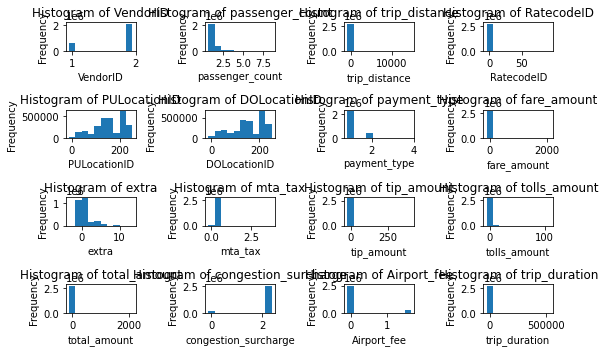

In [0]:
plt.figure(figsize=(16, 8))
for i, col_name in enumerate(['VendorID', 'passenger_count', 'trip_distance', 'RatecodeID', 'PULocationID', 'DOLocationID', 'payment_type', 'fare_amount', 'extra',
       'mta_tax', 'tip_amount', 'tolls_amount',
       'total_amount', 'congestion_surcharge', 'Airport_fee', 'trip_duration']):

    hist_data = df_filtered.select(col_name).rdd.flatMap(lambda x: x).histogram(10)  # 10 bins

    # hist_data[0] = list of bin edges
    # hist_data[1] = counts per bin

    bin_edges = hist_data[0]
    bin_counts = hist_data[1]

    # Plot using matplotlib
    plt.subplot(4,4,i+1)
    plt.bar(bin_edges[:-1], bin_counts, width=[bin_edges[i+1] - bin_edges[i] for i in range(len(bin_edges)-1)])
    plt.xlabel(col_name)
    plt.ylabel("Frequency")
    plt.title(f"Histogram of {col_name}")

plt.tight_layout()
plt.show()

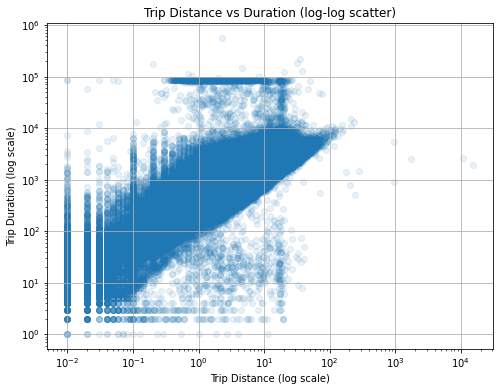

In [0]:
pandas_df = df_filtered.select("trip_distance", "trip_duration").toPandas()

# Step 3: Plot using matplotlib
plt.figure(figsize=(8, 6))
plt.scatter(pandas_df['trip_distance'], pandas_df['trip_duration'], alpha=0.1)
plt.xscale('log')
plt.yscale('log')
plt.xlabel("Trip Distance (log scale)")
plt.ylabel("Trip Duration (log scale)")
plt.title("Trip Distance vs Duration (log-log scatter)")
plt.grid(True)
plt.show()

In [0]:
# Fill missing values
df_filled = df.na.fill({"age": 30, "salary": 40000.0, "category": "Unknown"})
df_filled.show()